In [1]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly_express as px
from plotly.subplots import make_subplots
import calmap
import warnings
import folium
import geopandas as gpd
%matplotlib inline
import requests
warnings.simplefilter(action='ignore', category=FutureWarning)

In [2]:
# Movemos el directorio activo a esa localización
os.chdir('cbs/')
# Leemos todos los archivos en una línea
cbs = pd.concat([pd.read_csv(elem) for elem in os.listdir() if elem.endswith(".csv") and elem.startswith("2")]).reset_index(drop=True)

C:\Users\Carlos\AppData\Local\Temp\ipykernel_12160\3357077591.py:4: DtypeWarning: Columns (5,7) have mixed types. Specify dtype option on import or set low_memory=False.
  cbs = pd.concat([pd.read_csv(elem) for elem in os.listdir() if elem.endswith(".csv") and elem.startswith("2")]).reset_index(drop=True)


In [3]:
cbs.drop(columns=['Start station number', 'End station number', 'ride_id', 'rideable_type', 'start_station_id', 'end_station_id',
            'start_lat', 'start_lng', 'end_lat', 'end_lng'], inplace= True)
cbs['Start date'] = cbs[['Start date', 'started_at']].fillna('').sum(axis=1)
cbs['End date'] = cbs[['End date', 'ended_at']].fillna('').sum(axis=1)
cbs['Start station'] = cbs[['Start station', 'start_station_name']].fillna('').sum(axis=1)
cbs['End station'] = cbs[['End station', 'end_station_name']].fillna('').sum(axis=1)
cbs['Member type'] = cbs[['Member type', 'member_casual']].fillna('').sum(axis=1).str.lower()
cbs.drop(columns=['started_at', 'ended_at', 'start_station_name', 'end_station_name', 'member_casual'], inplace= True)
#https://stackoverflow.com/questions/41509577/how-to-merge-pandas-columns-within-the-same-dataframe

In [4]:
# combierto en formato datetime las fechas
cbs['Start date'] = pd.to_datetime(cbs['Start date'])
cbs['End date'] = pd.to_datetime(cbs['End date'])
# transformo la columna duración de segundos a minutos
cbs['Duration'] = (cbs['Duration']/ 60).round(2)
# hacer el nuevo cálculo de duration, renombrar la columna cómo 'Duration (min)'
from datetime import datetime as dt
cbs['Duration_2'] = (cbs['End date'] - cbs['Start date']).dt.total_seconds() / 60 # https://practicaldatascience.co.uk/data-science/how-to-calculate-the-time-difference-between-two-dates-in-pandas

cbs['Duration'] = cbs[['Duration', 'Duration_2']].fillna('').sum(axis=1)
cbs.drop(columns=['Duration_2'], inplace= True)
# renombro la columna
cbs.rename(columns = {'Duration':'Duration (min)'}, inplace=True)

In [5]:
# Creación columna hora
from datetime import *
cbs['date_hour'] = cbs['Start date'].dt.strftime('%Y-%m-%d %H:00:00')
# Transformación tipo de dato a fecha y tiempo
cbs['date_hour'] = pd.to_datetime(cbs['date_hour'])

In [6]:
# Filtro por tipo de miembro 'Casual'
casual_member = cbs[cbs['Member type']== 'casual']
casual_member = casual_member.groupby(['date_hour']).count().reset_index()
# Quitar la hora del índice
#casual_member = casual_member.reset_index()
# Elimino columnas por ser información redundante
casual_member.drop(columns= ['Start date', 'End date', 'Start station','End station', 'Bike number', 'Duration (min)'], inplace= True)
# Cambio el nombre de la columna ya que ahora no es representativo
casual_member.rename(columns= {'Member type': 'casual_count'}, inplace= True)

In [7]:
# Filtro por tipo de miembro 'Member'
registered_member = cbs[cbs['Member type']== 'member']
registered_member = registered_member.groupby(['date_hour']).count().reset_index()
# Quitar la hora del índice
#registered_member = registered_member.reset_index()
# Elimino columnas por ser información redundante
registered_member.drop(columns= ['Start date', 'End date', 'Start station','End station', 'Bike number', 'Duration (min)'], inplace= True)
# Cambio el nombre de la columna ya que ahora no es representativo
registered_member.rename(columns= {'Member type': 'registered_count'}, inplace= True)

In [8]:
# muevo el directorio activo a la carpeta anterior (antes lo movimos a la carperta cbs/)
os.chdir('..')
# lectura datos del clima
weather_data = pd.read_csv('weatherdata_wdc.csv', parse_dates=['datetime'])
# redondeo las filas del tiempo según los minutos, a la hora
weather_data["hour_datetime"] = weather_data["datetime"].dt.round("H") # https://stephenallwright.com/pandas-datetime-round-to-hour/
# elimino los valores duplicados según la columna hora
weather_data.drop_duplicates(subset=['hour_datetime'], inplace= True)
# elimino columna de dirección del viento
weather_data.drop(columns= ['wind_dir_deg', 'Unnamed: 0','datetime'], inplace= True)
# cambio tipo de dato a 'humidity'
#weather_data = weather_data.astype({"humidity":"int","pressure":"int"})

In [9]:
# Combino los datasets por la hora utilizando un tipo de unión inner
df_hourly = pd.merge(registered_member, weather_data, left_on= 'date_hour', right_on= 'hour_datetime', how= 'outer')
# Elimino la columna 'Hour' del dataset combinado
df_hourly.drop(columns= 'hour_datetime', inplace= True)
# Sustituyo los valores nulos en la columna 'registered_count' por 0, ya que no había ningun dato en el dataset original en esas horas
df_hourly['registered_count'].fillna(0, inplace= True)
# elimino la variable para evitar el consumo de RAM innecesario
del registered_member

# Combino los datasets por la hora utilizando un tipo de unión inner
df_hourly = pd.merge(casual_member, df_hourly, on= 'date_hour', how= 'outer')
# Elimino la columna 'Hour' del dataset combinado
#df_hourly.drop(columns= 'hour_datetime', inplace= True)
# Sustituyo los valores nulos en la columna 'registered_count' por 0, ya que no había ningun dato en el dataset original en esas horas
df_hourly['casual_count'].fillna(0, inplace= True)
# elimino la variable para evitar el consumo de RAM innecesario
del casual_member

In [10]:
# Filtro por tipo de miembro 'Member'
#registered_member = cbs[cbs['Member type']== 'member']
dur_avg = cbs.groupby(['date_hour'])['Duration (min)'].mean().reset_index().round(2)
# Combino los datasets por la hora utilizando un tipo de unión inner
df_hourly = pd.merge(dur_avg, df_hourly, on= 'date_hour', how= 'outer')
# elimino la variable para evitar el consumo de RAM innecesario
del dur_avg

In [11]:
# Creo rango de fechas por hora
dates = pd.date_range(start='2016-01-01', end = '2022-10-31', freq='H')
# Creo nuevo dataframe únicamente con una columna, las fechas por hora que acabamos de crear
date_range = pd.DataFrame(columns=['dates'])
date_range['dates'] = dates

In [12]:
# Combino los datasets por la hora utilizando un tipo de unión outer
df_hourly = pd.merge(date_range, df_hourly, left_on= 'dates', right_on= 'date_hour', how= 'left')
# Elimino la columna datetime ya que tenemos la columna 'dates' con todas las fechas
df_hourly.drop(columns= 'date_hour', inplace= True)
# Añadir columna mes, día, hora y día de la semana
df_hourly['year'] = df_hourly['dates'].dt.year
df_hourly['month'] = df_hourly['dates'].dt.month
df_hourly['day'] = df_hourly['dates'].dt.day # ¿Para qué? Quizás no es necesario
df_hourly['hour'] = df_hourly['dates'].dt.hour
df_hourly['weekday'] = df_hourly['dates'].dt.weekday # Lunes = 0, Domingo = 6

df_hourly.set_index('dates', inplace= True)

In [13]:
# Creación categorías para ver si es día de la semana o no
# Creación lista de condiciones
conditions = [
    (df_hourly['weekday'] <= 4),
    (df_hourly['weekday'] >= 5)]
# Creación lista de valores a asignar por condición
values = [True, False]
# Creación nueva columna y uso de np.select para asignar valores a las condiciones
df_hourly['workday'] = np.select(conditions, values)

In [14]:
df_hourly = df_hourly.astype({'year':'str', 'month': 'str', 'weekday': 'str', 'workday': 'str'})
# uso map() en vez de replace()
df_hourly['month'].replace({'1': 'Enero', '2': 'Febrero', '3': 'Marzo', '4': 'Abril', '5': 'Mayo', '6': 'Junio', '7': 'Julio', '8': 'Agosto', 
        '9': 'Septiembre', '10': 'Octubre', '11': 'Noviembre', '12': 'Diciembre'}, inplace= True)

df_hourly['weekday'].replace({'0': 'L', '1': 'M', '2': 'X', '3': 'J', '4': 'V', '5': 'S', '6': 'D'}, inplace= True)
df_hourly['workday'].replace({'0': 'No laborable', '1': 'Laborable'}, inplace= True)

In [15]:
# Añadir columna año a cbk
cbs['year'] = cbs['Start date'].dt.year
cbs['month'] = cbs['Start date'].dt.month
cbs['day'] = cbs['Start date'].dt.day # ¿Para qué? Quizás no es necesario
cbs['hour'] = cbs['Start date'].dt.hour
cbs = cbs.astype({'month':'str'})

In [16]:
df_hourly['humidity'] = pd.to_numeric(df_hourly['humidity'],downcast="integer", errors='coerce')

In [17]:
# Eliminar valores nulos por la media de la hora del día de la semana del mes y del año que corresponda
df_hourly['casual_count'] = df_hourly.groupby(['year', 'month', 'weekday', 'hour'])['casual_count'].apply(lambda x: x.fillna(x.mean()))
df_hourly['registered_count'] = df_hourly.groupby(['year', 'month', 'weekday', 'hour'])['registered_count'].apply(lambda x: x.fillna(x.mean()))
df_hourly['temperature'] = df_hourly.groupby(['year', 'month', 'hour'])['temperature'].apply(lambda x: x.fillna(x.mean()))
df_hourly['pressure'] = df_hourly.groupby(['year', 'month', 'hour'])['pressure'].apply(lambda x: x.fillna(x.mean()))
df_hourly['humidity'] = df_hourly.groupby(['year', 'month', 'hour'])['humidity'].apply(lambda x: x.fillna(x.mean()))
df_hourly['icon'] = df_hourly.groupby(['year', 'month', 'hour'])['icon'].apply(lambda x: x.fillna(x.mean()))
df_hourly['wind_speed'] = df_hourly.groupby(['year', 'month', 'hour'])['wind_speed'].apply(lambda x: x.fillna(x.mean()))
df_hourly['icon'] = df_hourly.groupby(['year', 'month', 'hour'])['icon'].apply(lambda x: x.fillna(x.mean()))

In [18]:
# cambio tipo de dato a 'humidity' y 'pressure'
df_hourly = df_hourly.astype({"humidity":"int","pressure":"int"})

In [19]:
# Creo columna con la suma de los usuarios casual y los registrados
df_hourly['new_count'] = df_hourly['casual_count'] + df_hourly['registered_count']

<Figure size 6400x6400 with 0 Axes>

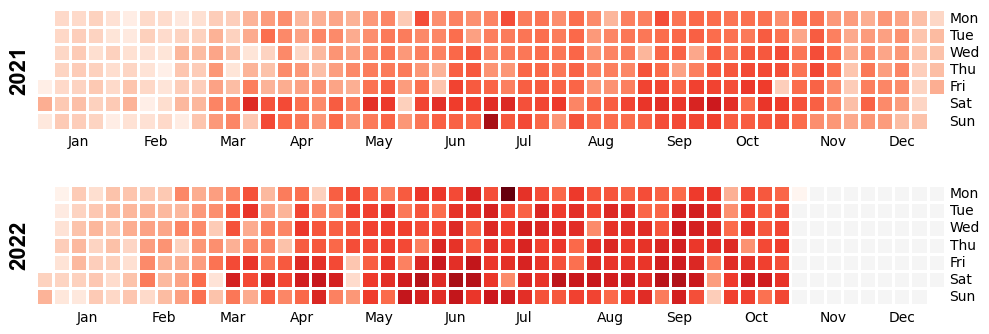

In [20]:
# gráfico calendario
plt.figure(figsize=(80,80), dpi= 80)
calmap.calendarplot(df_hourly[df_hourly['year']>='2021']['new_count'], fig_kws={'figsize': (10,4)}, yearlabel_kws={'color':'black', 'fontsize':16})
plt.show()

In [21]:
# Agrupo por estación y año, lo que me da la cuenta de usuarios por año
anual_users_station = pd.DataFrame(cbs.groupby(['Start station', 'year']).size().unstack(fill_value=0).reset_index().values,
                        columns=["Start station", "2016", "2017", "2018", "2019", "2020", "2021", "2022"])
# Creo columna de los años del dataframe
anual_users_station['Anual iniciated Trips average (5 last Yrs)'] = anual_users_station[anual_users_station.columns.difference(["Start station",
                    "2022", "2016"])].mean(axis=1).astype(int)
# https://stackoverflow.com/questions/34734940/row-wise-average-for-a-subset-of-columns-with-missing-values
# https://stackoverflow.com/questions/32032836/select-everything-but-a-list-of-columns-from-pandas-dataframe

In [22]:
# Vamos a obtener de la API proporcionada por Capital Bike Share datos sobre las ubicaciones de las estaciones de bicis
url = 'https://maps2.dcgis.dc.gov/dcgis/rest/services/DCGIS_DATA/Transportation_WebMercator/MapServer/5/query?where=1%3D1&outFields=*&outSR=4326&f=json'
respuesta = requests.get(url)
# Obtenemos los datos y los convertimos a diccionaro formato JSON.
respuesta = respuesta.json()
# Asigno a variable la selección del diccionario: key 'features' y de la lista que hay dentro, todos sus elementos
respuesta = respuesta['features'][:]
# Selección de cada diccionario dentro de la lista y conversión a dataframe
respuesta = pd.json_normalize(respuesta) # https://stackoverflow.com/questions/54321290/how-to-convert-list-of-nested-dictionary-to-pandas-dataframe
# Renombro las columnas eliminando attributed. de cada columna
respuesta = respuesta.rename(columns=lambda x: x.split('.')[-1]) # https://stackoverflow.com/questions/64998101/how-to-remove-part-of-the-column-name
# Conviero el df en GeoDataframe asignando el argumento geometry, necesario para dibujar el mapa con Folium
respuesta = gpd.GeoDataFrame(respuesta, crs= 'epsg:4326',geometry= gpd.points_from_xy(respuesta['LONGITUDE'], respuesta['LATITUDE'])) # https://geopandas.org/en/stable/gallery/create_geopandas_from_pandas.html
# Combino el dataset
respuesta = pd.merge(respuesta, anual_users_station, left_on='NAME', right_on = 'Start station', how='inner')
# Cambio el nombre a la columna 'address' para que en el mapa aparezca 'Station'
respuesta.rename(columns= {'NAME': 'station'}, inplace= True)
# Elimino columnas que no se van a utilizar
respuesta.drop(columns= ['STATION_ID', 'OBJECTID', 'STATION_STATUS', 'LAST_REPORTED', 'NUM_DOCKS_AVAILABLE', 'NUM_EBIKES_AVAILABLE',
                        'NUM_BIKES_DISABLED', 'IS_INSTALLED', 'IS_RETURNING', 'IS_RENTING', 'HAS_KIOSK', 'IOS', 'ANDROID', 'ELECTRIC_BIKE_SURCHARGE_WAIVER',
                        'EIGHTD_HAS_KEY_DISPENSER', 'CAPACITY', 'REGION_ID', 'GIS_LAST_MOD_DTTM', 'GIS_ID', 'NUM_DOCKS_DISABLED',
                        'NUM_BIKES_AVAILABLE'], inplace= True)
# Cambio los nombres de las columnas para que todas estén en minúsculas
respuesta.columns = respuesta.columns.str.lower()

In [23]:
# Vamos a obtener de la API proporcionada por Capital Bike Share datos sobre las ubicaciones de las estaciones de bicis
url = 'https://maps2.dcgis.dc.gov/dcgis/rest/services/DCGIS_DATA/Administrative_Other_Boundaries_WebMercator/MapServer/17/query?outFields=*&where=1%3D1&f=geojson'
barrios2 = requests.get(url)
# Obtenemos los datos y los convertimos a diccionaro formato JSON.
barrios2 = barrios2.json()
# Asigno a variable la selección del diccionario: key 'features' y de la lista que hay dentro, todos sus elementos
barrios2 = barrios2['features'][:]
# Selección de cada diccionario dentro de la lista y conversión a dataframe
barrios2 = pd.json_normalize(barrios2) # https://stackoverflow.com/questions/54321290/how-to-convert-list-of-nested-dictionary-to-pandas-dataframe

In [24]:
# Leo archivo GeoJSON con geopandas
barrios = gpd.read_file(r"Neighborhood_Clusters.geojson")
# web oficial descarga dataset barrios Washington D.C.: https://opendata.dc.gov/datasets/neighborhood-clusters/explore?location=38.893761%2C-77.014470%2C12.24

# Elimino las columnas que no se van a utilizar
barrios.drop(columns= ['WEB_URL', 'TYPE', 'CREATOR', 'CREATED', 'EDITOR', 'EDITED',
                        'SHAPEAREA', 'SHAPELEN'], inplace= True)
# Cambio los nombres de las columnas para que todas estén en minúsculas
barrios.columns = barrios.columns.str.lower()
# Cambio el nombre a la columna 'nbh_names' para que en el mapa aparezca 'neighborhood'
barrios.rename(columns= {'nbh_names': 'neighborhood'}, inplace= True)

In [25]:
# Uno los datasets asignando a cada estación su barrio: https://geopandas.org/en/stable/gallery/spatial_joins.html
cbs_map_data =  respuesta.sjoin(barrios, how="left", predicate="within")

In [26]:
# Agrupo por barrio para conocer el número de estaciones por barrio y luego poder combinarlo
stations_per_neighborhood = cbs_map_data.groupby('neighborhood').count().reset_index()
stations_per_neighborhood.drop(columns= ['longitude', 'station', 'station_type', 'rental_methods', 'region_name', 'x', 'y', 'geometry',
                                    'start station', '2016', '2017', '2018', '2019', '2020', '2021', '2022', 
                                    'anual iniciated trips average (5 last yrs)', 'index_right', 'objectid','name', 'globalid'], inplace = True)
stations_per_neighborhood.rename(columns= {'latitude': 'number of stations'}, inplace= True)

In [27]:
# Uno los datasets asignando a cada estación su barrio: https://geopandas.org/en/stable/gallery/spatial_joins.html
cbs_map_data2 =  barrios.sjoin(respuesta, how="left", predicate="within")
# Elimino columnas que no tienen sentido en este caso
cbs_map_data2.drop(columns= ['index_right', 'latitude', 'longitude', 'station', 'station_type', 'rental_methods',
                        'region_name', 'x', 'y', 'start station', '2016', '2017', '2018', '2019', '2020', '2021', '2022',
                        'anual iniciated trips average (5 last yrs)'], inplace= True)

In [28]:
# Combino el dataset con las estaciones por barrio
cbs_map_data2 = pd.merge(cbs_map_data2, stations_per_neighborhood, on = 'neighborhood', how= 'left')
# relleno los valores nulos con 0s
cbs_map_data2.fillna(0, inplace =True)
# el barrio pasa a ser el índice, es necesario para dibujar el choropleth map con plotly
cbs_map_data2.set_index('neighborhood', inplace= True)

In [29]:
fig = px.choropleth_mapbox(cbs_map_data2,
                   geojson=cbs_map_data2['geometry'],
                   locations=cbs_map_data2.index,
                   hover_name = cbs_map_data2['name'],
                   color="number of stations",
                   center={"lat": 38.9049093, "lon": -77.0042995},
                   mapbox_style="stamen-toner",
                   opacity= 0.7,
                   color_continuous_scale="ylorrd",
                   zoom=11.5)

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [30]:
# reseteo el índice para poder utilizar los barrios cómo columna en el siguiente gráfico
cbs_map_data2.reset_index(inplace = True)

In [151]:
# gráfico mostrando los clusters proporcionalmente por el número de estaciones que tienen: https://plotly.com/python/treemaps/
fig = px.treemap(cbs_map_data2, path=['neighborhood'], values='number of stations',color_discrete_sequence=px.colors.sequential.Oryel[::-1],
                width=750, height=600)

fig.update_traces(root_color="lightgrey")
fig.update_layout(margin = dict(t=40, l=0, r=0, b=0), uniformtext=dict(minsize=9, mode='show'), template='plotly_white', 
        title="Distritos por tamaño según la cantidad de estaciones")
fig.show()

In [ ]:
m = folium.Map(location=[38.9049093, -76.9942995], zoom_start=14, tiles= 'cartodbpositron', attr= 'https://deparkes.co.uk/2016/06/10/folium-map-tiles/')
for i in range(0,len(respuesta[respuesta['anual iniciated trips average (5 last yrs)']>0])):
   folium.CircleMarker(
      location=[respuesta.iloc[i]['latitude'], respuesta.iloc[i]['longitude']],
      tooltip=respuesta.iloc[i][['station', 'anual iniciated trips average (5 last yrs)']],
      radius=float(respuesta.iloc[i]['anual iniciated trips average (5 last yrs)'])/1500,
      color='#ee3123',
      fill=True,
      fill_color='#ee3123'
   ).add_to(m)

folium.TileLayer('openstreetmap', attr= 'https://deparkes.co.uk/2016/06/10/folium-map-tiles/').add_to(m)
folium.TileLayer('stamentoner', attr= 'https://deparkes.co.uk/2016/06/10/folium-map-tiles/').add_to(m)
folium.LayerControl().add_to(m)
m
# save as a standalone html file: m.save('../../static/interactiveCharts/313-bubble-map-with-folium.html')

In [ ]:
fig = px.histogram(respuesta[respuesta['anual iniciated trips average (5 last yrs)']>27000].sort_values(by= "anual iniciated trips average (5 last yrs)"), 
            x="anual iniciated trips average (5 last yrs)", y="station", barmode='group',text_auto='.2s',
            color_discrete_sequence=px.colors.sequential.Oryel[::-1])
fig.update_layout(title='Top 10 estaciones por cantidad de viajes', yaxis_title=None, xaxis_title='Cantidad de viajes iniciados', showlegend=False,
                yaxis=dict(showgrid=False), template= 'plotly_white')

fig.show()

In [33]:
fig = go.Figure(go.Indicator(
    mode = "number+delta",
    value = len(cbs[cbs['year']==2022]['Start station'].unique()),
    title = {'text': "Total Estaciones<br><span style='font-size:0.8em;color:gray'>Último Año</span>"},
    delta = {'reference': len(cbs[cbs['year']==2021]['Start station'].unique())},
    domain = {'x': [0, 1], 'y': [0, 1]}))

fig.show()

In [69]:
# Creación gráfico de donut
values_pie = cbs[cbs['year']>= 2017].groupby(['Member type'])['Duration (min)'].count().reset_index()
values_pie.rename(columns= {'Duration (min)': 'Number of users'}, inplace= True)
colors = {"casual": "#f5deb3", "member": "#ff6347"} #https://stackoverflow.com/questions/66518387/python-plotly-graph-objects-discrete-color-map-like-in-plotly-express
values_pie["Color"] = values_pie['Member type'].apply(lambda x: colors.get(x)) #to connect Column value to Color in Dict

fig = px.pie(values_pie, values='Number of users', names='Member type', hole=.5, labels= 'Member type', color_discrete_sequence=px.colors.sequential.RdBu)
fig.update_traces(hoverinfo='label+percent', insidetextorientation= 'horizontal',
                textinfo='label+percent', textfont_size=20, marker=dict(colors=values_pie["Color"], line=dict(color='#000000', width=0)))
fig.add_annotation(x= 0.5, y = 0.5,
                    text = 'Total usuarios<br>{:,}'.format(values_pie['Number of users'].sum()),
                    font = dict(size=20,family='Verdana', 
                                color='black'),
                    showarrow = False)
fig.update_layout(title_text='Últimos 5 años', title_x=0.50, showlegend=False)
fig.show() # https://towardsdatascience.com/pie-donut-charts-with-plotly-d5524a60295b
del values_pie

In [142]:
#creo variables para agregar los datos y hacer los gráficos https://www.statology.org/pandas-groupby-bar-plot/
casual_by_year = df_hourly.groupby(['year'])['casual_count'].sum().reset_index()
registered_by_year = df_hourly.groupby(['year'])['registered_count'].sum().reset_index()
newcount_by_year = df_hourly.groupby(['year'])['new_count'].sum().reset_index()

fig = go.Figure()
fig.add_trace(go.Bar(x= casual_by_year['year'], y= casual_by_year['casual_count'],marker=dict(color="wheat"), text=casual_by_year['casual_count'],
            textposition='outside', texttemplate='%{text:.2s}', name='Casual'))
fig.add_trace(go.Bar(x= registered_by_year['year'], y= registered_by_year['registered_count'],marker=dict(color="tomato"), name='Miembro',
            text=registered_by_year['registered_count'], textposition='outside', texttemplate='%{text:.2s}'))
fig.add_trace(go.Line(x= newcount_by_year['year'], y= newcount_by_year['new_count'],marker=dict(size=15, color="goldenrod"), name='Ambos'))
fig.update_layout(template='plotly_white', title="Cantidad de usuarios por año", legend_title_text='Tipo de Usuario',
            legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1))
fig.show()
del casual_by_year, registered_by_year, newcount_by_year

c:\Users\Carlos\Documents\Formación\Upgrade Hub Bootcamp\samplerepo\analytics\lib\site-packages\plotly\graph_objs\_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




In [221]:
areachart_df = df_hourly.reset_index()
fig = px.area(areachart_df, x='dates', y='new_count', title='Cantidad de usuarios en el tiempo', template= 'plotly_white',
            color_discrete_sequence=["goldenrod"])

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.update_layout(yaxis_title=None, xaxis_title=None, showlegend=False,
                yaxis=dict(showgrid=False))
fig.show()
del areachart_df

In [110]:
fig = px.violin(df_hourly, y = 'month', x= 'casual_count', color= 'month', color_discrete_sequence=px.colors.sequential.Oryel[::-1], 
        orientation= 'h', template = 'plotly_white', points=False).update_traces(side="positive", width=2)
fig.update_layout(title='Casual', yaxis_title=None, xaxis_title='Cantidad de Usuarios', showlegend=False,
                yaxis=dict(showgrid=False), xaxis= dict(range=[-30,400]))

fig.show()

In [109]:
fig = px.violin(df_hourly, y = 'month', x= 'registered_count', color= 'month', color_discrete_sequence=px.colors.sequential.Oryel, 
        orientation= 'h', template = 'plotly_white', points=False).update_traces(side="positive", width=2)
fig.update_layout(title='Miembro', yaxis_title=None, xaxis_title='Cantidad de Usuarios', showlegend=False,
                yaxis=dict(showgrid=False), xaxis= dict(range=[-50,750]))

fig.show()

In [118]:
fig = px.box(df_hourly, x="hour", y="new_count", color= "hour", template = 'plotly_white', color_discrete_sequence=px.colors.sequential.Oryel[::-1],
            notched= True)
fig.update_layout(title='Cantidad de usuarios por cada hora del día', yaxis_title=None, xaxis_title='Hora',
    xaxis=dict(showgrid=False, dtick= 1), showlegend=False)

fig.show()

In [154]:
fig = plt.figure(figsize=[8,7])
fig = px.line(df_hourly.groupby(['weekday','hour'])['new_count'].mean().reset_index(), x='hour', y='new_count', color='weekday', 
                color_discrete_sequence=px.colors.qualitative.D3[::-1], markers=True, template = 'simple_white', 
                category_orders={"weekday": ["L", "M", "X", "J", "V", "S", "D"]})

fig.update_layout(title='Cantidad de usuarios por cada hora del día', yaxis_title=None, xaxis_title=None,
    xaxis=dict(showgrid=True, dtick= 1, range=[0,23]), yaxis= dict(range=[0,1200], showgrid=True), showlegend=True, legend_title_text='Día de la semana',
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1))

fig.show()

<Figure size 800x700 with 0 Axes>

In [36]:
colors = {"Laborable": "#67001F", "No laborable": "#B2182B"} #https://stackoverflow.com/questions/66518387/python-plotly-graph-objects-discrete-color-map-like-in-plotly-express
df_hourly["Color"] = df_hourly['workday'].apply(lambda x: colors.get(x)) #to connect Column value to Color in Dict

# Create subplots: use 'domain' type for Pie subplot
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]])
fig.add_trace(go.Pie(labels= df_hourly['workday'], values=df_hourly['casual_count'],name="Usuarios casuales", 
                insidetextorientation= 'horizontal'), 1, 1)
fig.add_trace(go.Pie(labels= df_hourly['workday'], values= df_hourly['registered_count'], name="Usuarios registrados", 
                insidetextorientation= 'horizontal'), 1, 2)

# Use `hole` to create a donut-like pie chart
fig.update_traces(hole=.4, hoverinfo="label+percent+name",textinfo='label+percent', marker=dict(colors=df_hourly["Color"],
                              line=dict(color='#000000', width=0)))

fig.update_layout(coloraxis_autocolorscale=True, coloraxis_colorscale= ['wheat','tomato'], title_text="Uso por tipo de usuario en días laborables o no",
    # Add annotations in the center of the donut pies.
    annotations=[dict(text='  Casual', x=0.18, y=0.5, font_size=20, showarrow=False),
                dict(text='Miembro', x=0.82, y=0.5, font_size=20, showarrow=False)], showlegend=False,legend_title_text='Día laborable',
                legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="center", x=1))
fig.show()

In [ ]:
# Creo grupos de la duración media y mediana por tipo de miembro, luego creo dataframe con los datos de la media y la mediana
duration_avg = cbs.groupby('Member type')['Duration (min)'].mean().reset_index()
duration_avg.rename(columns= {'Duration (min)': 'Avg Duration (min)'}, inplace= True)
duration_median = cbs.groupby('Member type')['Duration (min)'].median().reset_index()
duration_median.rename(columns= {'Duration (min)': 'Median Duration (min)'}, inplace= True)
duration_plot = pd.merge(duration_avg, duration_median, how= 'inner', on= 'Member type')
del duration_avg, duration_median

fig= go.Figure() # https://towardsdatascience.com/lollipop-dumbbell-charts-with-plotly-696039d5f85
fig.add_trace(go.Scatter(x = duration_plot["Median Duration (min)"], 
                          y = duration_plot["Member type"],
                          mode = 'markers+text',
                          marker_color = 'royalblue',
                          marker_size = 15,
                          name = 'Mediana',
                          text= duration_plot["Median Duration (min)"],
                          textposition='top center',
                          texttemplate='%{text:.2s}'))
fig.add_trace(go.Scatter(x = duration_plot["Avg Duration (min)"], 
                          y = duration_plot["Member type"],
                          mode = 'markers+text',
                          marker_color = 'tomato', 
                          marker_size = 15,
                          name = 'Media',
                          text= duration_plot["Avg Duration (min)"],
                          textposition='top center',
                          texttemplate='%{text:.2s}'))
for i in range(0, len(duration_plot)):
               fig.add_shape(type='line',
                              x0 = duration_plot["Median Duration (min)"][i],
                              y0 = i,
                              x1 = duration_plot["Avg Duration (min)"][i],
                              y1 = i,
                              line=dict(color='silver', width = 2.5))
fig.update_layout(title_text = "Duración del viaje", template='plotly_white', xaxis_title= 'Duración (minutos)',
                legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1))
fig.show()
del duration_plot

In [121]:
#import plotly.figure_factory as ff
corr =  df_hourly[['casual_count', 'registered_count', 'temperature', 'wind_speed', 'humidity']].corr(method = 'spearman').round(2).sort_values(by = 'registered_count',
                axis = 0, ascending = False).sort_values(by = 'registered_count', axis = 1,ascending = False)

mask = np.triu(np.ones_like(corr, dtype=bool))
corr = corr.mask(mask)
fig = px.imshow(corr.to_numpy().round(2), x=list(corr.index.values), y=list(corr.columns.values), zmin=-1, zmax=1, text_auto=".2f",
    color_continuous_scale='Hot', aspect="auto", template= 'plotly_white')

fig.update_layout(title_text='<b>Matriz de correlación<b>',
                  title_x=0.5,
                  titlefont={'size': 24},
                  width=550, height=550,
                  xaxis_showgrid=False,
                  xaxis={'side': 'bottom'},
                  yaxis_showgrid=False,
                  yaxis_autorange='reversed')
fig.show() # https://www.kaggle.com/code/desalegngeb/plotly-guide-customize-for-better-visualizations

In [146]:
fig = px.density_heatmap(df_hourly, x="temperature", y="new_count", color_continuous_scale="Spectral", template= 'plotly_white',
                    range_y= [0,450], range_x= [-10,38])
fig.show()

# Modelo predictivo

In [25]:
# reseteo el índice para que tenga la fecha cómo columna en vez de índice
df_hourly.reset_index(inplace= True)

In [26]:
df_hourly1 = df_hourly

In [28]:
# elimino columnas que no son necesarias para el modelo
df_hourly1.drop(columns= ['Duration (min)', 'casual_count', 'temperature', 'humidity', 'pressure', 'icon', 'wind_speed',
        'description', 'year', 'month', 'day', 'hour', 'weekday', 'workday', 'new_count'], inplace= True)

In [29]:
from neuralprophet import NeuralProphet
# Renombramos columnas (deben llamarse exactamente así)
df_hourly1.rename(columns = {'dates':'ds', 'registered_count':'y'}, inplace = True)
# Cambiamos formato a fechas
df_hourly1['ds'] = pd.DatetimeIndex(df_hourly1['ds'])
# Mostramos
df_hourly1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59881 entries, 0 to 59880
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   ds      59881 non-null  datetime64[ns]
 1   y       59869 non-null  float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 935.8 KB


In [31]:
# filtro para utilizar únicamente desde mayor a octubre del 2022 para la predicción
df_hourly1 = df_hourly1[df_hourly1['ds']>= '2022-05']

In [32]:
# Instanciamos clase
m = NeuralProphet()
# Partimos datos especificando unidad mínima de tiempo
df_train, df_val = m.split_df(df_hourly1, freq='H', valid_p = 0.2)
# Entrenamos modelo
metrics = m.fit(df_train, freq='H', validation_df=df_val)

INFO - (NP.df_utils._infer_frequency) - Major frequency H corresponds to 99.977% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - H
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils._infer_frequency) - Major frequency H corresponds to 99.972% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - H
INFO - (NP.config.init_data_params) - Setting normalization to global as only one dataframe provided for training.
INFO - (NP.utils.set_auto_seasonalities) - Disabling yearly seasonality. Run NeuralProphet with yearly_seasonality=True to override this.
INFO - (NP.config.set_auto_batch_epoch) - Auto-set batch_size to 32
INFO - (NP.config.set_auto_batch_epoch) - Auto-set epochs to 135


  0%|          | 0/138 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 4.32E-01, min: 1.68E+00


  0%|          | 0/138 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 4.46E-02, min: 9.51E-02
INFO - (NP.forecaster._init_train_loader) - lr-range-test selected learning rate: 1.24E-01
  0%|          | 0/135 [00:00<?, ?it/s]WARNING - (py.warnings._showwarnmsg) - c:\Users\Carlos\Documents\Formacion\Upgrade_Hub_Bootcamp\samplerepo\analytics\lib\site-packages\torch\nn\modules\loss.py:928: UserWarning: Using a target size (torch.Size([878])) that is different to the input size (torch.Size([878, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.smooth_l1_loss(input, target, reduction=self.reduction, beta=self.beta)

Epoch[135/135]: 100%|██████████| 135/135 [00:29<00:00,  4.56it/s, SmoothL1Loss=0.0111, MAE=76.9, RMSE=105, Loss=0.00838, RegLoss=0, MAE_val=254, RMSE_val=314, SmoothL1Loss_val=0.0966]


<AxesSubplot: >

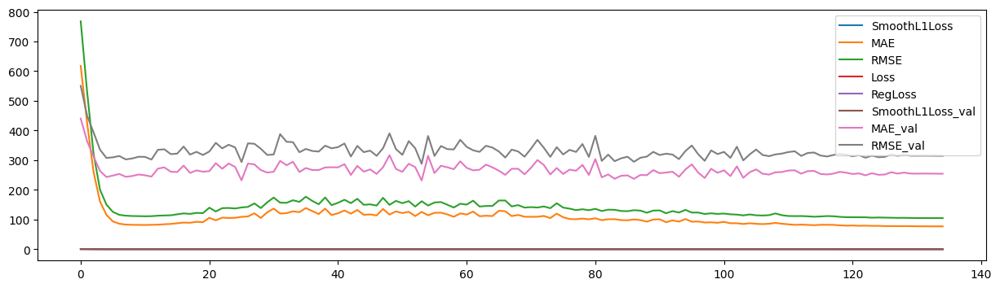

In [33]:
metrics.plot(figsize=(15,4))

In [34]:
future = m.make_future_dataframe(df_hourly1, periods=8760, n_historic_predictions=len(df_hourly1))
forecast = m.predict(future)

INFO - (NP.df_utils._infer_frequency) - Major frequency H corresponds to 99.977% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - H
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils._infer_frequency) - Major frequency H corresponds to 99.992% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - H
INFO - (NP.df_utils._infer_frequency) - Major frequency H corresponds to 99.992% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - H
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column


In [35]:
forecast.shape

(13153, 7)

In [36]:
forecast.tail()

,ds,y,residual1,yhat1,trend,season_weekly,season_daily
13148,2023-10-30 20:00:00,NaN,NaN,1020.400513,960.991882,-3.904184,63.312809
13149,2023-10-30 21:00:00,NaN,NaN,924.769897,961.056458,-1.699247,-34.587372
13150,2023-10-30 22:00:00,NaN,NaN,865.598511,961.121033,0.469773,-95.992332
13151,2023-10-30 23:00:00,NaN,NaN,812.513672,961.185791,2.596336,-151.268448
13152,2023-10-31 00:00:00,NaN,NaN,754.856140,961.250366,4.674337,-211.068512


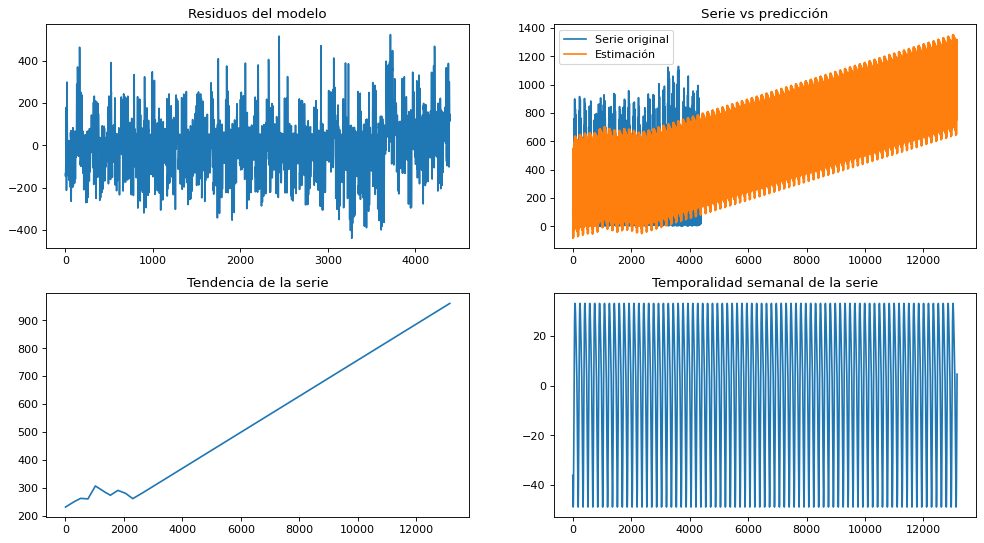

In [38]:
# Creamos gráfico
f = plt.figure(figsize=(15, 8), dpi=80)
# Preparamos primer componente
ax1 = f.add_subplot(221)
ax1.set_title('Residuos del modelo')
ax1.plot(forecast['residual1'])
# Preparamos segundo componente
ax2 = f.add_subplot(222)
ax2.set_title('Serie vs predicción')
ax2.plot(forecast['y'])
ax2.plot(forecast['yhat1'])
ax2.legend(['Serie original', 'Estimación'])
# Preparamos tercer componente
ax3 = f.add_subplot(223)
ax3.set_title('Tendencia de la serie')
ax3.plot(forecast['trend'])
# Preparamos cuarto componente
ax4 = f.add_subplot(224)
ax4.set_title('Temporalidad semanal de la serie')
ax4.plot(forecast['season_weekly'])

In [39]:
areachart_df = forecast.reset_index()
fig = px.area(areachart_df, x='ds', y='yhat1', title='Time Series with Range Slider and Selectors', template= 'plotly_white',
            color_discrete_sequence=px.colors.sequential.Oryel)

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()
del areachart_df